In [155]:
import urllib.request
import pandas as pd
import numpy as np
from datetime import datetime,timedelta,date

In [156]:
from IPython.display import display, HTML, Markdown

paramOpt=2
changeCSV=False
adjustParam=False
paramSave=False
selectDRS=False

In [157]:
dfSP = pd.read_csv("data/dados_municipios_SP.csv.gz",compression='gzip')
dfSP
dfSP.query('DRS == "{}"'.format('DRS 01 - Grande São Paulo'))

,date,state,city,place_type,confirmed,deaths,order_for_place,is_last,popEst,estimated_population,city_ibge_code,confirmed_per_100k_inhabitants,death_rate,DRS
10946,2021-02-27,SP,Arujá,city,3912,131,322,True,89824.0,91157.0,3503901.0,4291.49709,0.0335,DRS 01 - Grande São Paulo
10947,2021-02-26,SP,Arujá,city,3878,130,321,False,89824.0,91157.0,3503901.0,4254.19880,0.0335,DRS 01 - Grande São Paulo
10948,2021-02-25,SP,Arujá,city,3845,130,320,False,89824.0,91157.0,3503901.0,4217.99752,0.0338,DRS 01 - Grande São Paulo
10949,2021-02-24,SP,Arujá,city,3819,130,319,False,89824.0,91157.0,3503901.0,4189.47530,0.0340,DRS 01 - Grande São Paulo
10950,2021-02-23,SP,Arujá,city,3804,129,318,False,89824.0,91157.0,3503901.0,4173.02017,0.0339,DRS 01 - Grande São Paulo
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
179626,2020-03-30,SP,Vargem Grande Paulista,city,2,1,5,False,52597.0,53468.0,3556453.0,3.74056,0.5000,DRS 01 - Grande São Paulo
179627,2020-03-27,SP,Vargem Grande Paulista,city,2,1,4,False,52597.0,53468.0,3556453.0,3.74056,0.5000,DRS 01 - Grande São Paulo
179628,2020-03-26,SP,Vargem Grande Paulista,city,1,1,3,False,52597.0,53468.0,3556453.0,1.87028,1.0000,DRS 01 - Grande São Paulo
179629,2020-03-25,SP,Vargem Grande Paulista,city,0,1,2,False,52597.0,53468.0,3556453.0,NaN,0.0000,DRS 01 - Grande São Paulo


In [158]:
if paramOpt==0:
    paramFile="data/param.csv"
    version = "1"
    model = "ManualIC"
    
if paramOpt==1:
    version = "116"
    paramFile="data/param_optimized_Yabox_HistMin"+version+".csv"
    model = "YaboxIC" 

if paramOpt==2:
    version = "119"
    paramFile="data/param_optimized_Yabox_HistMin"+version+".csv"
    model = "YaboxIC" 

In [159]:
dfparam = pd.read_csv(paramFile)
dfparam = dfparam.dropna()
dfparam.e0=0
dfparam.r0=0

display(Markdown("## Original Initial Parameters"))
display(dfparam)

## Original Initial Parameters

,DRS,start-date,prediction-range,s0,e0,a0,i0,r0,d0,START,RATIO,WCASES,WREC
0,DRS 01 - Grande São Paulo,2020-03-17,200,12401753,0,0,77,0,144,28,0.15,0.6916,0.0
1,DRS 02 - Araçatuba,2020-03-28,200,472813,0,0,101,0,228,170,0.15,0.2024,0.0
2,DRS 03 - Araraquara,2020-04-04,200,888473,0,0,237,0,107,153,0.15,0.5406,0.0
3,DRS 04 - Baixada Santista,2020-03-29,200,1404254,0,0,128,0,162,68,0.15,0.2692,0.0
4,DRS 05 - Barretos,2020-04-02,200,218591,0,0,243,0,21,235,0.15,0.4606,0.0
5,DRS 06 - Bauru,2020-03-28,200,1077595,0,0,109,0,125,230,0.15,0.3942,0.0
6,DRS 07 - Campinas,2020-04-02,200,2241910,0,0,16,0,101,52,0.15,0.2033,0.0
7,DRS 08 - Franca,2020-04-04,200,269546,0,0,81,0,56,12,0.15,0.4050,0.0
8,DRS 09 - Marília,2020-03-29,200,695640,0,0,209,0,68,224,0.15,0.4908,0.0
9,DRS 10 - Piracicaba,2020-04-04,200,1186414,0,0,105,0,3,131,0.15,0.3074,0.0


In [160]:
selectDRS=False
if selectDRS:
    DRS=pd.Series(['DRS 08 - Franca','DRS 12 - Registro','DRS 05 - Barretos','DRS 01 - Grande São Paulo'])
else:
    DRS=dfparam.DRS 

In [161]:
allDistricts=True
cleanRecovered=False

if allDistricts:
    display(DRS)
else:
    districtRegionSelected="DRS 13 - Ribeirão Preto"
    display(districtRegionSelected)

0          DRS 01 - Grande São Paulo
1                 DRS 02 - Araçatuba
2                DRS 03 - Araraquara
3          DRS 04 - Baixada Santista
4                  DRS 05 - Barretos
5                     DRS 06 - Bauru
6                  DRS 07 - Campinas
7                    DRS 08 - Franca
8                   DRS 09 - Marília
9                DRS 10 - Piracicaba
10      DRS 11 - Presidente Prudente
11                 DRS 12 - Registro
12           DRS 13 - Ribeirão Preto
13    DRS 14 - São João da Boa Vista
14    DRS 15 - São José do Rio Preto
15                 DRS 16 - Sorocaba
16                  DRS 17 - Taubaté
Name: DRS, dtype: object

In [162]:
%matplotlib inline 
import matplotlib.pyplot as plt
import pandas as pd
%reload_ext autoreload
%autoreload 2
import covid_plots_v2 as covid_plots
%config InlineBackend.figure_format ='retina'

In [163]:
#DRS 01 - Grande São Paulo
#DRS 02 - Araçatuba
#DRS 03 - Araraquara
#DRS 04 - Baixada Santista
#DRS 05 - Barretos
#DRS 06 - Bauru
#DRS 07 - Campinas
#DRS 08 - Franca
#DRS 09 - Marília
#DRS 10 - Piracicaba
#DRS 11 - Presidente Prudente
#DRS 12 - Registro
#DRS 13 - Ribeirão Preto
#DRS 14 - São João da Boa Vista
#DRS 15 - São José do Rio Preto
#DRS 16 - Sorocaba
#DRS 17 - Taubaté

#main district region for analysis
districtRegion = "DRS 01 - Grande São Paulo"

#select districts for plotting
districts4Plot=['DRS 10 - Piracicaba',
               'DRS 06 - Bauru',
               'DRS 07 - Campinas',
               'DRS 03 - Araraquara',
               districtRegion]


#Choose here your options
#opt=0 all plots
#opt=1 corona log plot
#opt=2 logistic model prediction
#opt=3 bar plot with growth rate
#opt=4 log plot + bar plot
#opt=5 SEAIR-D Model
opt = 5

#number of cases to start plotting model in log graph - real data = 100
startCase=100

In [164]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines){
    return false;}

<IPython.core.display.Javascript object>

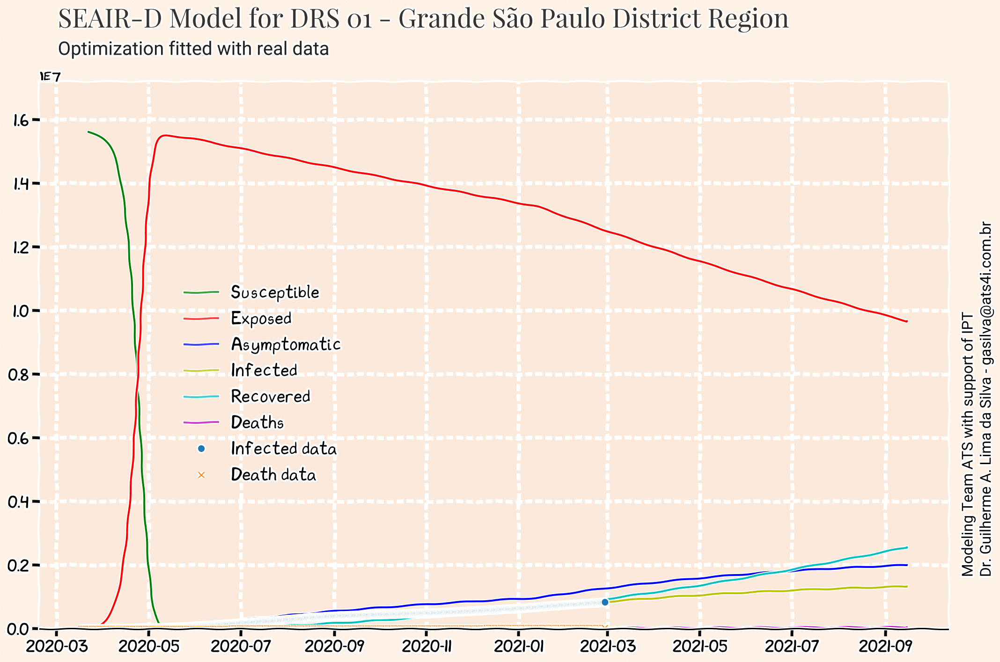

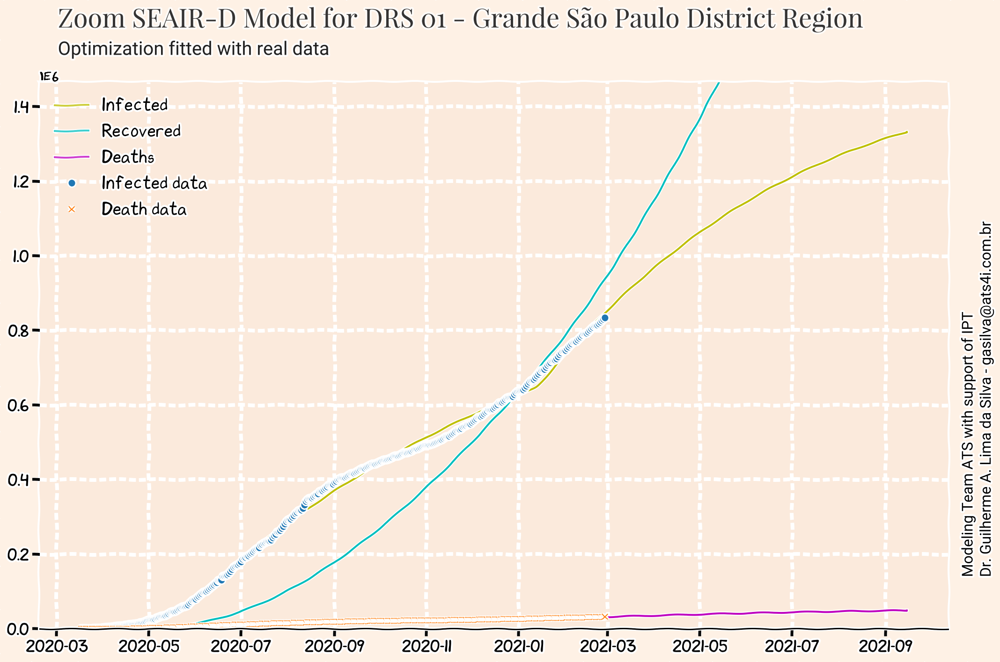

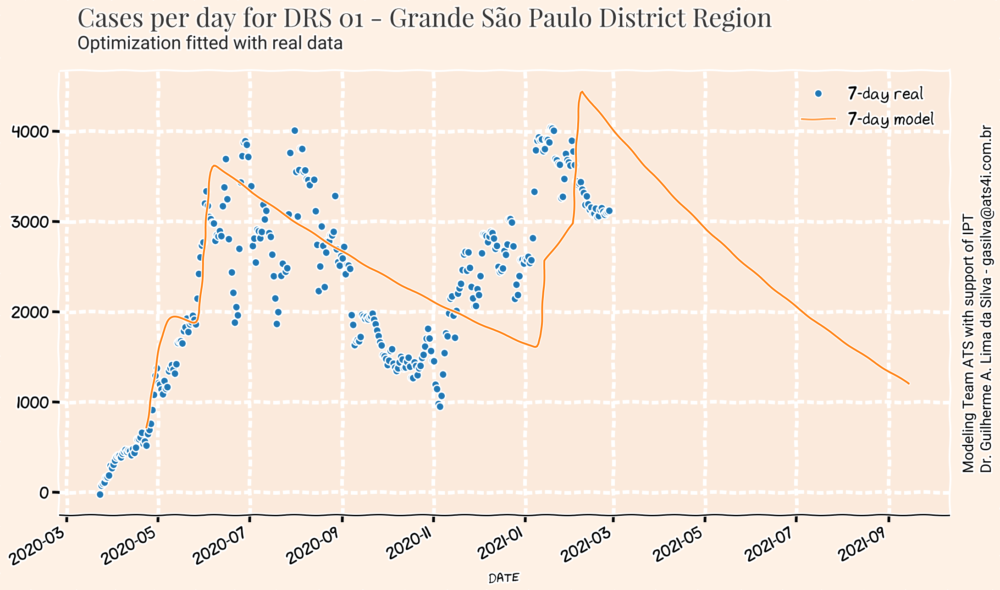

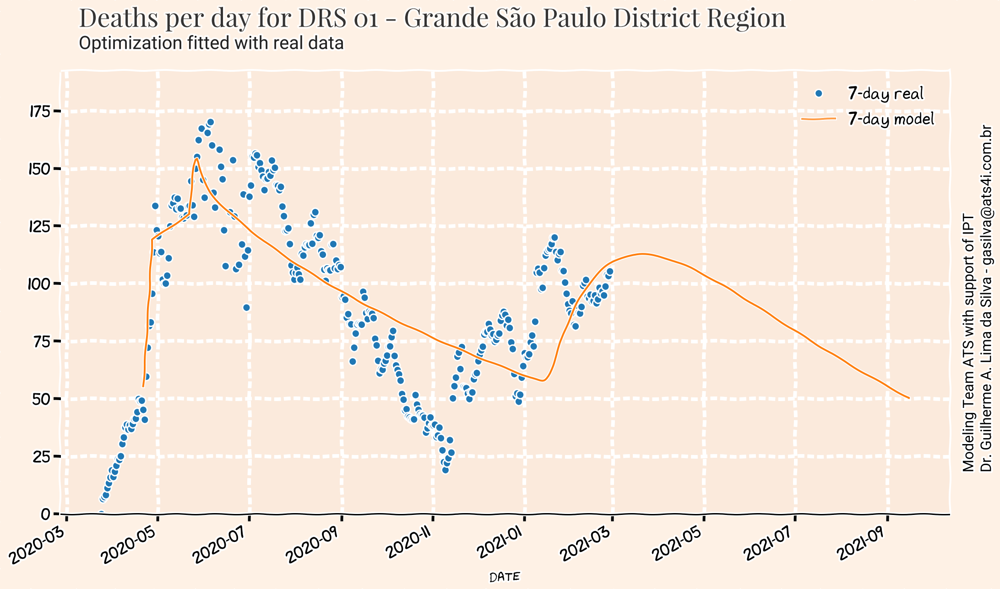

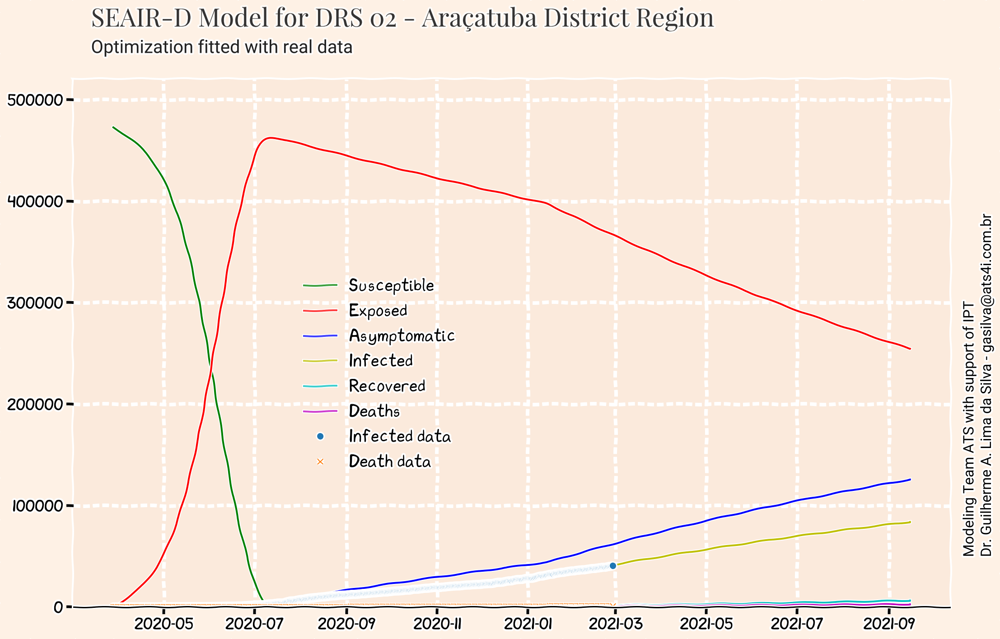

...

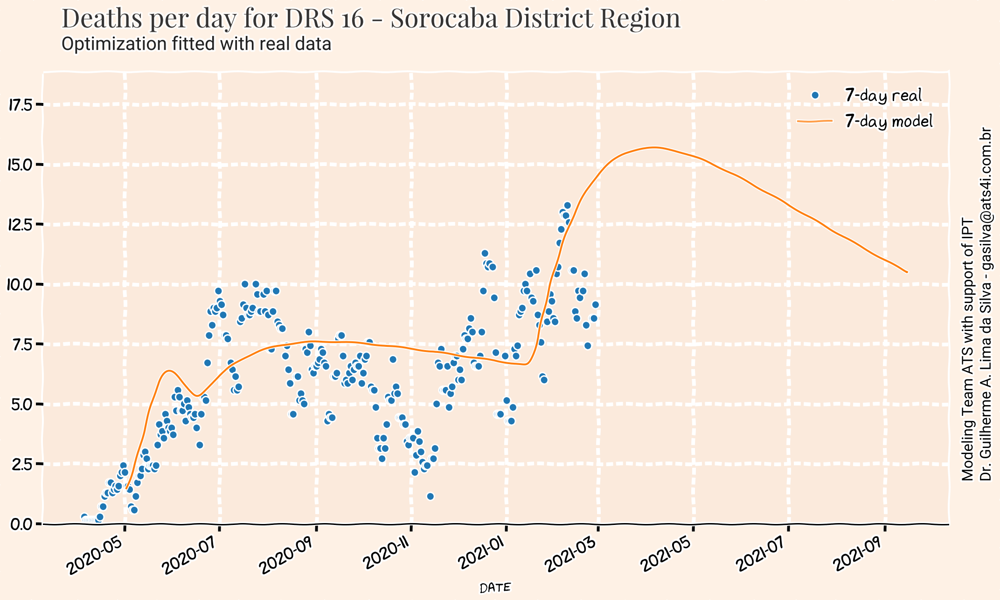

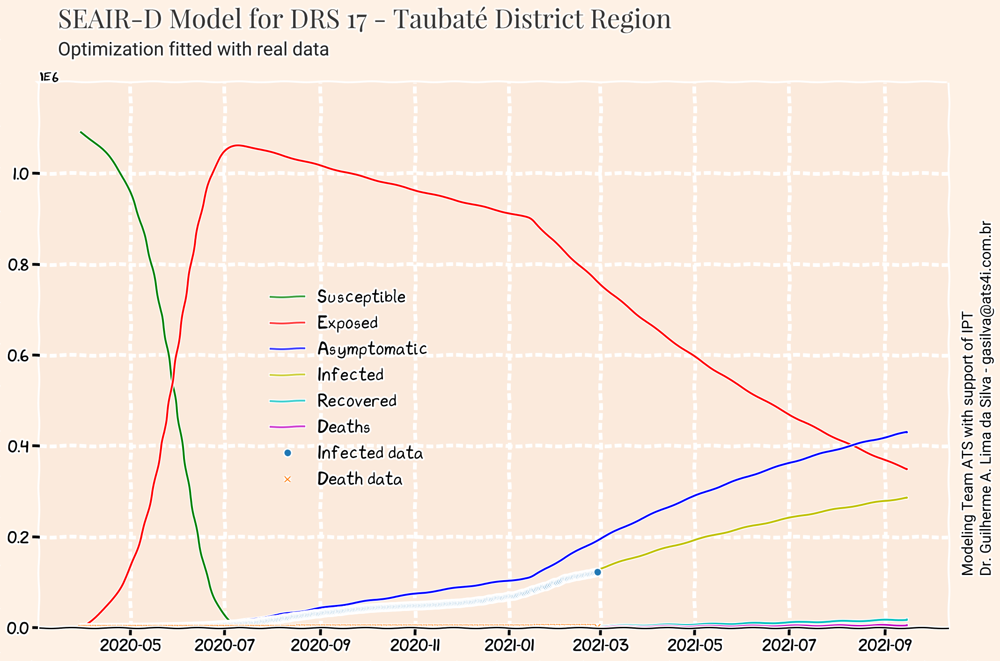

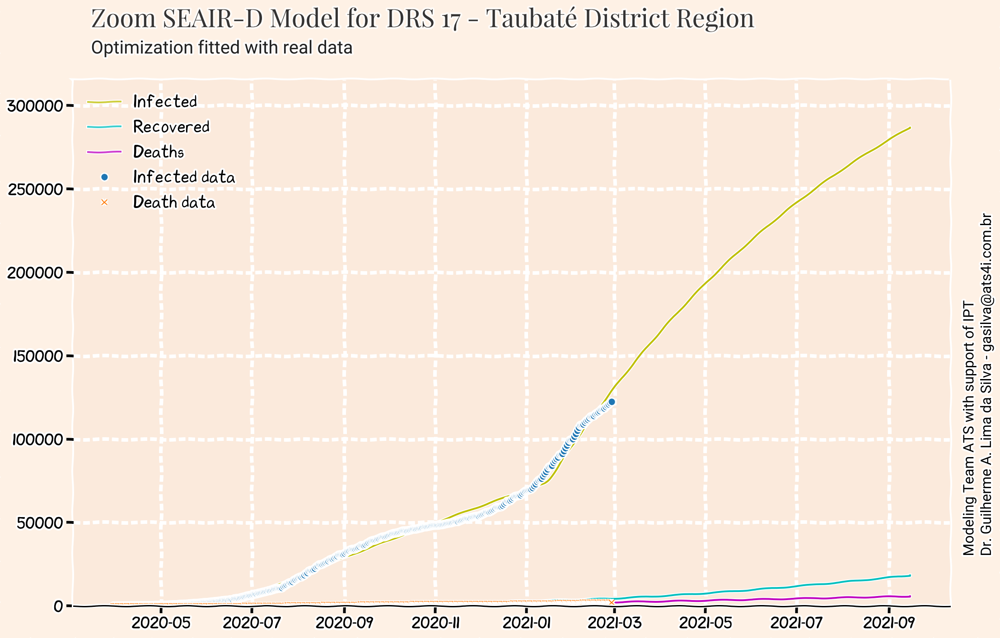

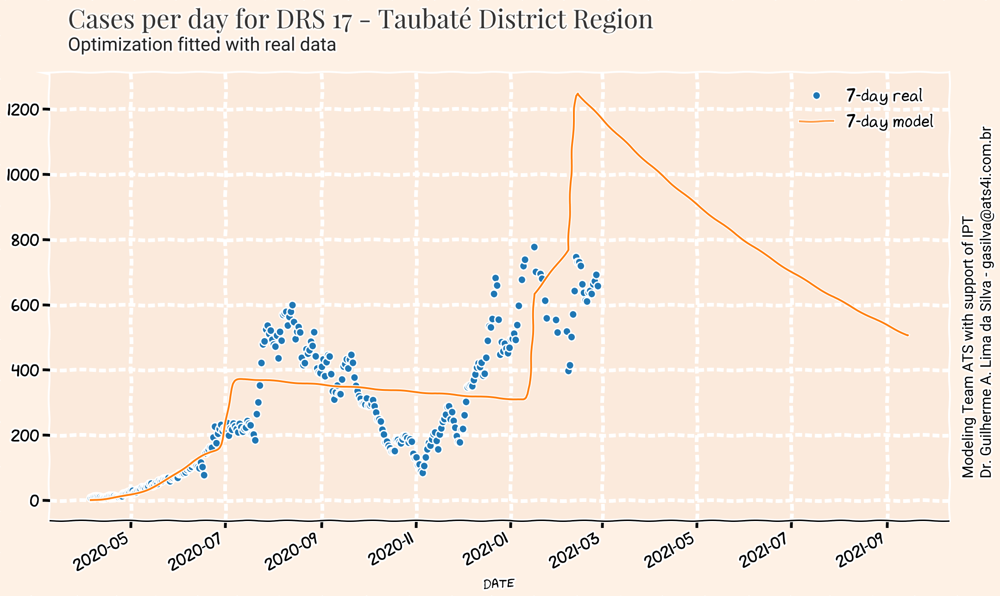

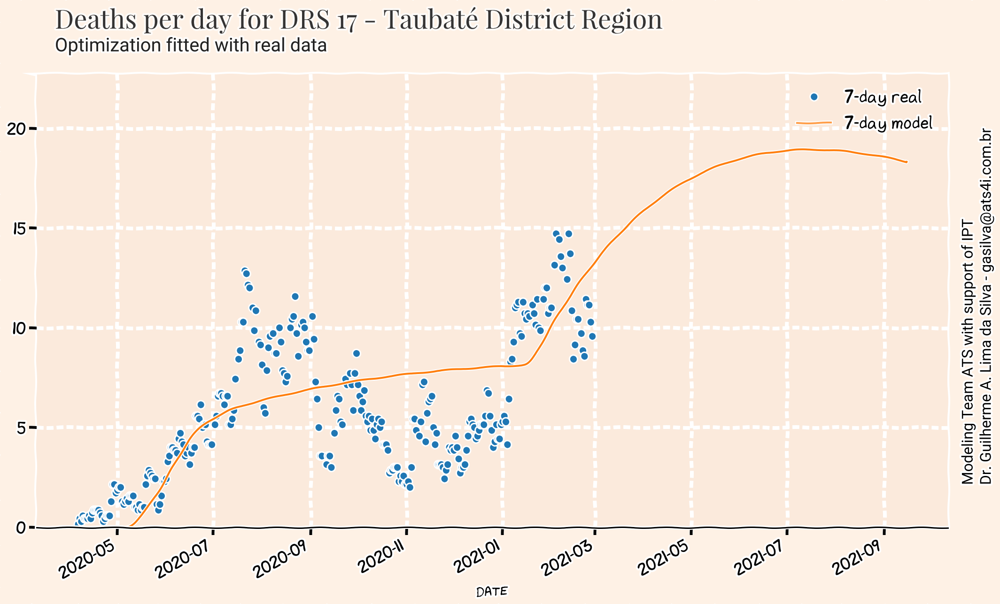

In [165]:
selectLastDate=False

#plots one district or all districts  
if opt==5:
    allDistricts=True
else:
    allDistricts=False
    
if not allDistricts:
    DRS=[districtRegion]
        
for districtRegion in DRS:
    query = dfparam.query('DRS == "{}"'.format(districtRegion)).reset_index()
    ratio = query['RATIO'][0]
    startCase = query['START'][0]
    startdate = query['start-date'][0]
    predict_range = query['prediction-range'][0]

    #calcula data máxima dos gráficos
    #100 dias é usado como máximo dos cálculos da derivada das mortes
    if selectLastDate:
        lastDate="2021-01-18"
    else:
        lastDate=dfSP.date.max()
    maxDate= datetime.strptime(lastDate, "%Y-%m-%d") + timedelta(days = 300) #"2020-08-31"
    maxDateStr = maxDate.strftime("%Y-%m-%d")

    covid_plots.covid_plots(districtRegion, districts4Plot, startdate, predict_range, \
                    startCase, opt, version, show=True, ratio=ratio, maxDate=maxDateStr, model=model,lastDate=lastDate)